# Establishing Localized Safe Zones to Mitigate Against the Spread of a Pandemic


#### Applied Data Science Capstone


This study will look into the feasibility of establishing county-leve; ‘safe zones’ – counties in parts of the country that are - and can be kept - free of the COVID-19 virus.

FOr the purposes of this study, a 'safe zone' is defined as:

* a county that has fewer than five confirmed cases of COVID-19, 
* has sufficient temporary housing (hotels, RV parks, campgrounds etc.) to supplort an influx of people
* has medical facilities to treat non-COVID-19 cases
* has stores, restaurants and recreational facilities to support a (somewhat) normal lifestyle

It is thought that the best chance of meeting the first requirement will be in a state with low COVID-19 cases when compared to the rest of the United States. To do this, let's download the *Johns Hopkins University Center for Systems Science and Engineering (CSSE)* data on COVID-19 cases. 

In [10]:
# Install dependencies
import pandas as pd
import numpy as np
import folium
import json
from geopy.geocoders import Nominatim
import requests
from pandas import json_normalize
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline 

print('Libraries imported.')

Libraries imported.


In [12]:
# Read in the data and create a dataframe
df = pd.read_csv('data/time_series_covid19_confirmed_US.csv')
df.head(10)

,UID,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,...,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20
0,16,AS,ASM,16,60.0,NaN,American Samoa,US,-14.271000,-170.132000,...,0,0,0,0,0,0,0,0,0,0
1,316,GU,GUM,316,66.0,NaN,Guam,US,13.444300,144.793700,...,51,55,56,58,69,77,82,84,93,112
2,580,MP,MNP,580,69.0,NaN,Northern Mariana Islands,US,15.097900,145.673900,...,0,0,0,0,2,6,6,6,6,6
3,630,PR,PRI,630,72.0,NaN,Puerto Rico,US,18.220800,-66.590100,...,79,100,127,174,239,286,316,316,452,475
4,850,VI,VIR,850,78.0,NaN,Virgin Islands,US,18.335800,-64.896300,...,19,22,0,0,30,30,30,37,40,42
5,84001001,US,USA,840,1001.0,Autauga,Alabama,US,32.539527,-86.644082,...,6,6,6,6,7,8,10,12,12,12
6,84001003,US,USA,840,1003.0,Baldwin,Alabama,US,30.727750,-87.722071,...,5,10,15,18,19,20,24,28,29,29
7,84001005,US,USA,840,1005.0,Barbour,Alabama,US,31.868263,-85.387129,...,0,0,0,0,0,0,0,1,2,2
8,84001007,US,USA,840,1007.0,Bibb,Alabama,US,32.996421,-87.125115,...,0,0,0,2,3,3,4,4,4,5
9,84001009,US,USA,840,1009.0,Blount,Alabama,US,33.982109,-86.567906,...,4,5,5,5,5,5,6,9,10,10


#### Understanding the data
Let's take an initial look at the data.

In [13]:
print(df.columns)
print(df.dtypes)
df.describe()

Index(['UID', 'iso2', 'iso3', 'code3', 'FIPS', 'Admin2', 'Province_State',
       'Country_Region', 'Lat', 'Long_', 'Combined_Key', '1/22/20', '1/23/20',
       '1/24/20', '1/25/20', '1/26/20', '1/27/20', '1/28/20', '1/29/20',
       '1/30/20', '1/31/20', '2/1/20', '2/2/20', '2/3/20', '2/4/20', '2/5/20',
       '2/6/20', '2/7/20', '2/8/20', '2/9/20', '2/10/20', '2/11/20', '2/12/20',
       '2/13/20', '2/14/20', '2/15/20', '2/16/20', '2/17/20', '2/18/20',
       '2/19/20', '2/20/20', '2/21/20', '2/22/20', '2/23/20', '2/24/20',
       '2/25/20', '2/26/20', '2/27/20', '2/28/20', '2/29/20', '3/1/20',
       '3/2/20', '3/3/20', '3/4/20', '3/5/20', '3/6/20', '3/7/20', '3/8/20',
       '3/9/20', '3/10/20', '3/11/20', '3/12/20', '3/13/20', '3/14/20',
       '3/15/20', '3/16/20', '3/17/20', '3/18/20', '3/19/20', '3/20/20',
       '3/21/20', '3/22/20', '3/23/20', '3/24/20', '3/25/20', '3/26/20',
       '3/27/20', '3/28/20', '3/29/20', '3/30/20', '3/31/20', '4/1/20',
       '4/2/20', '4/3/20', '4

,UID,code3,FIPS,Lat,Long_,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,...,3/27/20,3/28/20,3/29/20,3/30/20,3/31/20,4/1/20,4/2/20,4/3/20,4/4/20,4/5/20
count,3.253000e+03,3253.000000,3251.000000,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000,...,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000,3253.000000
mean,8.390300e+07,839.444205,32090.929560,37.183790,-89.174224,0.000307,0.000307,0.000615,0.000615,0.001537,...,31.250231,37.343375,43.309560,49.740855,57.845681,65.589302,74.839533,84.716262,94.941592,103.616662
std,3.292495e+06,18.091158,17825.153176,8.623023,21.438640,0.017533,0.017533,0.024792,0.024792,0.039181,...,487.132499,567.051604,644.014019,717.309862,823.286486,908.891532,997.487720,1104.228135,1222.985097,1310.807618
min,1.600000e+01,16.000000,60.000000,-14.271000,-170.132000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,8.401904e+07,840.000000,19038.000000,34.237321,-98.037489,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,8.403005e+07,840.000000,30045.000000,38.147359,-89.825123,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,1.000000,1.000000,1.000000,2.000000,2.000000,2.000000,3.000000,3.000000,4.000000
75%,8.404701e+07,840.000000,47010.000000,41.684463,-82.793570,0.000000,0.000000,0.000000,0.000000,0.000000,...,5.000000,6.000000,7.000000,8.000000,10.000000,11.000000,13.000000,15.000000,17.000000,18.000000
max,8.410000e+07,850.000000,99999.000000,69.314792,145.673900,1.000000,1.000000,1.000000,1.000000,1.000000,...,25573.000000,29776.000000,33768.000000,37453.000000,43119.000000,47439.000000,51809.000000,57159.000000,63306.000000,67551.000000


For the purposes of this study, we're going to strip out everything except the following columns:
* 'Admin2' - the county name
* 'Province_State' - the state name
* '4/5/20' - the most recent total number of cases.

The easiest way to do this is to copy those columns to a new dataframe and rename them.

In [14]:
covid = df[['Admin2', 'Province_State', '4/5/20']].copy()
covid.columns=['county','state','cases']
covid.head()

,county,state,cases
0,NaN,American Samoa,0
1,NaN,Guam,112
2,NaN,Northern Mariana Islands,6
3,NaN,Puerto Rico,475
4,NaN,Virgin Islands,42


We can see that the data includes off-shore locations, which can be discounted for practical purposes. Let's remove American Samoa, Northern Mariana Islands, Virgin Islands, Guam, Puerto Rico and Hawaii. Let's also remove Diamond Princess, Grand Princess and Alaska for the same reason and then map the data for quicker visualization.

In [15]:
# Delete Northern Mariana Islands, Virgin Islands, Guam, Puerto Rico and Hawaii
drop_state = ['American Samoa',
              'Northern Mariana Islands',
              'Virgin Islands',
              'Guam',
              'Puerto Rico',
              'Hawaii',
              'Diamond Princess',
              'Grand Princess',
              'Alaska']
df_dropped = covid[~covid['state'].isin(drop_state)]
df_dropped.head()

,county,state,cases
5,Autauga,Alabama,12
6,Baldwin,Alabama,29
7,Barbour,Alabama,2
8,Bibb,Alabama,5
9,Blount,Alabama,10


In [16]:
# Now we'll group by state and see which states have the lowest number of cases
df_sorted = df_dropped.groupby('state').sum().reset_index()
df_covid = df_sorted.sort_values('cases')
df_covid

,state,cases
48,Wyoming,197
32,North Dakota,207
39,South Dakota,240
24,Montana,286
46,West Virginia,324
25,Nebraska,364
17,Maine,470
43,Vermont,512
27,New Hampshire,621
29,New Mexico,670


We an see that there is a wide range of cases, so let's look at cases by percentage of population.

To do this, we need population figures for each state. We can get these from the US Census Bureau via an API call.

In [17]:
# Install dependencies
import configparser
from configparser import ConfigParser
import requests
from pandas import json_normalize

# Read in the API key
config = configparser.ConfigParser(allow_no_value=True)
config.read('cred.cfg')
key = config["census"]["key"]

# Form the query
url = 'https://api.census.gov/data/2019/pep/population?get=POP,NAME&for=state:*&key={}'.format(key)

# Send the GET request
results = requests.get(url).json()

# Remove the headers
results.pop(0)

# Create a new dataframe from the results
df_pops = pd.DataFrame(results,columns=['pop','state','state_id'])
df_pops = df_pops.drop(columns='state_id')

# Merge with covid dataframe
df_final = pd.merge(df_covid, df_pops, on='state')

# Convert pop to integer
df_final['pop'] = df_final['pop'].astype(int)

# Calculate percentages
df_final['percentage'] = round(df_final['cases'] / df_final['pop'] * 100,2)

# Rename
df_covid = df_final
df_covid

,state,cases,pop,percentage
0,Wyoming,197,578759,0.03
1,North Dakota,207,762062,0.03
2,South Dakota,240,884659,0.03
3,Montana,286,1068778,0.03
4,West Virginia,324,1792147,0.02
5,Nebraska,364,1934408,0.02
6,Maine,470,1344212,0.03
7,Vermont,512,623989,0.08
8,New Hampshire,621,1359711,0.05
9,New Mexico,670,2096829,0.03


In [19]:
# Map it
states_geo = r'data/us_states.json'

usa_map = folium.Map(location=[38,-97], zoom_start=4, tiles = 'Mapbox Bright')
usa_map.choropleth(geo_data=states_geo,
                   data=df_final,
                   columns=['state', 'percentage'],
                   key_on='feature.properties.NAME',
                   fill_color='YlOrRd',
                   fill_opacity=0.7,
                   line_opacity=0.2,
                   legend_name='COVID-19 Cases',
                   reset=True)

usa_map

We see that most of the states have less than 0.12% of the population infected, so let's bin the data and plot to see where most of the figures lie.

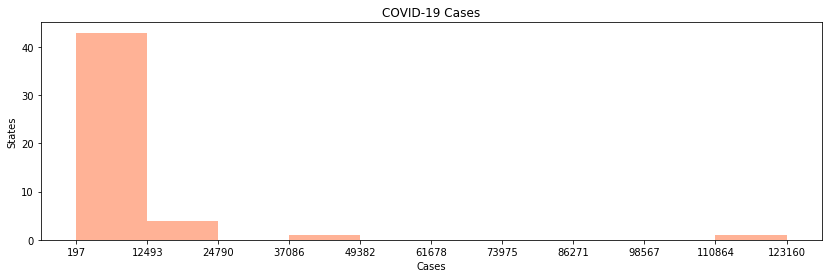

               cases           pop  percentage
count      49.000000  4.900000e+01   49.000000
mean     6851.469388  6.654941e+06    0.079796
std     18155.580829  7.428653e+06    0.107442
min       197.000000  5.787590e+05    0.020000
25%       837.000000  1.934408e+06    0.030000
50%      1855.000000  4.648794e+06    0.040000
75%      5675.000000  7.614893e+06    0.080000
max    123160.000000  3.951222e+07    0.630000


In [20]:
# let's get the x-tick values
count, bin_edges = np.histogram(df_final['cases'], 10)

# un-stacked histogram
df_final['cases'].plot(kind ='hist', 
          figsize=(14, 4),
          bins=10,
          alpha=0.6,
          xticks=bin_edges,
          color=['coral', 'darkslateblue', 'mediumseagreen']
         )

plt.title('COVID-19 Cases')
plt.ylabel('States')
plt.xlabel('Cases')

plt.show()
print(df_final.describe())

25% of states have less than 0.03% of the population affected, so lets focus on those.

In [21]:
# Filter for only states with fewer than 212493 cases
low_covid = df_covid[df_covid['percentage'] <= 0.03]
low_covid.head()

,state,cases,pop,percentage
0,Wyoming,197,578759,0.03
1,North Dakota,207,762062,0.03
2,South Dakota,240,884659,0.03
3,Montana,286,1068778,0.03
4,West Virginia,324,1792147,0.02


Wyoming looks promising with only 197 cases so let's take a look at the counties in Wyoming.

In [22]:
# Filter only on Wyoming
df_wyoming = df_dropped[df_dropped['state'] == 'Wyoming']

df_wyoming

,county,state,cases
3124,Albany,Wyoming,4
3125,Big Horn,Wyoming,0
3126,Campbell,Wyoming,7
3127,Carbon,Wyoming,4
3128,Converse,Wyoming,3
3129,Crook,Wyoming,0
3130,Fremont,Wyoming,37
3131,Goshen,Wyoming,2
3132,Hot Springs,Wyoming,0
3133,Johnson,Wyoming,8


In [23]:
# Add latitude and longitude
df_latlon = df[['Admin2', 'Province_State', 'Lat', 'Long_']].copy()
df_latlon.columns=['county','state','lat','lon']
df_latlon

,county,state,lat,lon
0,NaN,American Samoa,-14.2710,-170.1320
1,NaN,Guam,13.4443,144.7937
2,NaN,Northern Mariana Islands,15.0979,145.6739
3,NaN,Puerto Rico,18.2208,-66.5901
4,NaN,Virgin Islands,18.3358,-64.8963
...,...,...,...,...
3248,Unassigned,Washington,0.0000,0.0000
3249,Unassigned,West Virginia,0.0000,0.0000
3250,Unassigned,Wisconsin,0.0000,0.0000
3251,Unassigned,Wyoming,0.0000,0.0000


In [24]:
# Filter only on Wyoming
df_tmp = df_latlon[df_latlon['state'] == 'Wyoming']

# Drop state column
df_tmp.drop("state", axis = 1, inplace=True)
df_tmp

C:\Users\Mike\anaconda3\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,county,lat,lon
3124,Albany,41.654987,-105.723542
3125,Big Horn,44.524051,-107.996037
3126,Campbell,44.248861,-105.547440
3127,Carbon,41.693578,-106.932608
3128,Converse,42.972723,-105.508185
3129,Crook,44.588551,-104.569770
3130,Fremont,43.041840,-108.629689
3131,Goshen,42.087982,-104.353474
3132,Hot Springs,43.719307,-108.442317
3133,Johnson,44.040572,-106.584517


In [25]:
# Delete Out of WY and Unassigned
drop_county = ['Out of WY',
              'Unassigned']
df_wyoming_counties = df_wyoming[~df_wyoming['county'].isin(drop_county)]
df_wyoming_counties

,county,state,cases
3124,Albany,Wyoming,4
3125,Big Horn,Wyoming,0
3126,Campbell,Wyoming,7
3127,Carbon,Wyoming,4
3128,Converse,Wyoming,3
3129,Crook,Wyoming,0
3130,Fremont,Wyoming,37
3131,Goshen,Wyoming,2
3132,Hot Springs,Wyoming,0
3133,Johnson,Wyoming,8


In [28]:
# Merge
df_wy = pd.merge(df_tmp, df_wyoming_counties, on='county')
df_wy

,county,lat,lon,state,cases
0,Albany,41.654987,-105.723542,Wyoming,4
1,Big Horn,44.524051,-107.996037,Wyoming,0
2,Campbell,44.248861,-105.547440,Wyoming,7
3,Carbon,41.693578,-106.932608,Wyoming,4
4,Converse,42.972723,-105.508185,Wyoming,3
5,Crook,44.588551,-104.569770,Wyoming,0
6,Fremont,43.041840,-108.629689,Wyoming,37
7,Goshen,42.087982,-104.353474,Wyoming,2
8,Hot Springs,43.719307,-108.442317,Wyoming,0
9,Johnson,44.040572,-106.584517,Wyoming,8


In [29]:
states_geo = r'data/us_counties.json'

wyco_map = folium.Map(location=[42.99,-107.55], zoom_start=7)

# create a numpy array of length 6 and has linear spacing from the minium total immigration to the maximum total immigration
threshold_scale = np.linspace(df_wy['cases'].min(),
                              df_wy['cases'].max(),
                              6, dtype=int)
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1 # make sure that the last value of the list is greater than the maximum immigration


wyco_map.choropleth(geo_data=states_geo,
                   data=df_wy,
                   columns=['county', 'cases'],
                   key_on='feature.properties.NAME', 
                   threshold_scale=threshold_scale,
                   fill_color='YlOrRd',
                   fill_opacity=0.7,
                   line_opacity=0.2,
                   legend_name='COVID-19 Cases',
                   reset=True)

# add markers to identify number of cases
for lat, lon, label in zip(df_wy['lat'], df_wy['lon'], df_wy['cases']):
    icon = folium.DivIcon(html=label, icon_anchor = [0,-10])
    folium.Marker([lat,lon], icon=icon).add_to(wyco_map)

# add markers to identify county name
for lat, lon, label in zip(df_wy['lat'], df_wy['lon'], df_wy['county']):
    icon = folium.DivIcon(html=label)
    folium.Marker([lat,lon], icon=icon).add_to(wyco_map)
    
wyco_map

We can see some major towns and cities on the map but none are in counties with no cases. Sweetwater (Rock Springs), Uinta (Evanston) and Albany (Laramie) all have five or fewer cases so let's take a look at those cities in Foursquare.

In [30]:
address = 'Rock Springs, Wyoming'

geolocator = Nominatim(user_agent="wy_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of',address,'are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Rock Springs, Wyoming are 41.5869225, -109.2047867.


In [31]:
# Import Foursuare credentials
config = configparser.ConfigParser(allow_no_value=True)
config.read('cred.cfg')

CLIENT_ID = config["foursquare"]["c_id"]
CLIENT_SECRET = config["foursquare"]["c_sec"]
VERSION = '20180605' # Foursquare API version

# Set other attributes
LIMIT = 100 # limit of number of venues returned by Foursquare API
radius = 1000 # define radius
neighborhood_latitude = latitude
neighborhood_longitude = longitude

# create URL
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)

# Send the GET request
results = requests.get(url).json()

# Extract the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

# Clean the json and structure it into a pandas dataframe
venues = results['response']['groups'][0]['items']

# flatten JSON
rock_springs_venues = pd.json_normalize(venues) 

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
rock_springs_venues =rock_springs_venues.loc[:, filtered_columns]

# filter the category for each row
rock_springs_venues['venue.categories'] = rock_springs_venues.apply(get_category_type, axis=1)

# clean columns
rock_springs_venues.columns = [col.split(".")[-1] for col in rock_springs_venues.columns]
rock_springs_venues

,name,categories,lat,lng
0,Twisted Coffee,Coffee Shop,41.587475,-109.203436
1,Cherry Pie,Food,41.584180,-109.197780
2,L & S Fencing,Construction & Landscaping,41.578182,-109.205099
3,Iron Cowboy Crossfit,Gym / Fitness Center,41.587257,-109.216520


Doesn't seem to be very much in Rock Springs, so let's try Uinta County. The big city there is Evanston.

In [36]:
address = 'Evanston, Wyoming'
geolocator = Nominatim(user_agent="wy_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of',address,'are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Evanston, Wyoming are 41.2682462, -110.9637586.


In [37]:
neighborhood_latitude = latitude
neighborhood_longitude = longitude

# create URL
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)

# Send the GET request
results = requests.get(url).json()

# Extract the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

# Clean the json and structure it into a pandas dataframe
venues = results['response']['groups'][0]['items']

# flatten JSON
evanston_venues = pd.json_normalize(venues) 

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
evanston_venues =evanston_venues.loc[:, filtered_columns]

# filter the category for each row
evanston_venues['venue.categories'] = evanston_venues.apply(get_category_type, axis=1)

# clean columns
evanston_venues.columns = [col.split(".")[-1] for col in evanston_venues.columns]
evanston_venues

,name,categories,lat,lng
0,Bon Rico,Steakhouse,41.267831,-110.964946
1,Suds Bro Brewery,Brewery,41.268047,-110.966167
2,discount liquor,Liquor Store,41.264243,-110.956536
3,Wells Fargo Bank,Bank,41.266766,-110.962434
4,Dollar Tree,Discount Store,41.265615,-110.959847
5,Maurices,Women's Store,41.265668,-110.959341
6,Jimmy John's,Sandwich Place,41.262077,-110.956986
7,Papa Murphy's | Take 'N' Bake Pizza,Pizza Place,41.262791,-110.955807
8,Maverik Adventures First Stop,Gas Station,41.263974,-110.958391
9,Taco Time,Taco Place,41.264244,-110.957544


Not bad. How about Albany County. Let's look at Laramie.

In [41]:
address = 'Laramie, Wyoming'
geolocator = Nominatim(user_agent="wy_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of',address,'are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Laramie, Wyoming are 41.311367, -105.591101.


In [42]:
neighborhood_latitude = latitude
neighborhood_longitude = longitude

# create URL
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)

# Send the GET request
results = requests.get(url).json()

# Extract the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

# Clean the json and structure it into a pandas dataframe
venues = results['response']['groups'][0]['items']

# flatten JSON
laramie_venues = pd.json_normalize(venues) 

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
laramie_venues =laramie_venues.loc[:, filtered_columns]

# filter the category for each row
laramie_venues['venue.categories'] = laramie_venues.apply(get_category_type, axis=1)

# clean columns
laramie_venues.columns = [col.split(".")[-1] for col in laramie_venues.columns]
laramie_venues

,name,categories,lat,lng
0,The Crowbar and Grill,Bar,41.311978,-105.595159
1,Sweet Melissa's,Vegetarian / Vegan Restaurant,41.311546,-105.595963
2,Coal Creek TAP,Brewery,41.311074,-105.595750
3,The Prairie Rose,American Restaurant,41.309700,-105.595430
4,Qdoba Mexican Grill,Mexican Restaurant,41.314064,-105.593756
...,...,...,...,...
58,Sports Locker,Sporting Goods Shop,41.319101,-105.593179
59,Copper's Corner,Bar,41.320001,-105.592466
60,The Gardens,Coffee Shop,41.312212,-105.579515
61,Rolling Mill Cafe,Café,41.312230,-105.579445


Based on the number of venues, Uinta County (Evanston) and Albany County (Laramie) both seem to be potential locations. Let's grab some more data to make our decision on.

How about hospitals? Let's use the Hospital_General_Information.csv dataset from Data.gov.

In [43]:
# Read in the file and create a dataframe
df_hospitals = pd.read_csv('data/Hospital_General_Information.csv')
print(df_hospitals.columns)
df_hospitals.head()

Index(['Facility ID', 'Facility Name', 'Address', 'City', 'State', 'ZIP Code',
       'County Name', 'Phone Number', 'Hospital Type', 'Hospital Ownership',
       'Emergency Services', 'Meets criteria for meaningful use of EHRs',
       'Hospital overall rating', 'Hospital overall rating footnote',
       'Mortality national comparison',
       'Mortality national comparison footnote',
       'Safety of care national comparison',
       'Safety of care national comparison footnote',
       'Readmission national comparison',
       'Readmission national comparison footnote',
       'Patient experience national comparison',
       'Patient experience national comparison footnote',
       'Effectiveness of care national comparison',
       'Effectiveness of care national comparison footnote',
       'Timeliness of care national comparison',
       'Timeliness of care national comparison footnote',
       'Efficient use of medical imaging national comparison',
       'Efficient use of medi

,Facility ID,Facility Name,Address,City,State,ZIP Code,County Name,Phone Number,Hospital Type,Hospital Ownership,...,Readmission national comparison footnote,Patient experience national comparison,Patient experience national comparison footnote,Effectiveness of care national comparison,Effectiveness of care national comparison footnote,Timeliness of care national comparison,Timeliness of care national comparison footnote,Efficient use of medical imaging national comparison,Efficient use of medical imaging national comparison footnote,Location
0,031309,SAGE MEMORIAL HOSPITAL,STATE ROUTE 264 SOUTH 191,GANADO,AZ,86505,APACHE,(928) 755-4541,Critical Access Hospitals,Voluntary non-profit - Private,...,5.0,Not Available,16.0,Not Available,16.0,Not Available,5.0,Not Available,5.0,NaN
1,044021,WOODRIDGE BEHAVIORAL CENTER,600 NORTH 7TH STREET,WEST MEMPHIS,AR,72301,CRITTENDEN,(870) 394-4113,Psychiatric,Proprietary,...,19.0,Not Available,19.0,Not Available,19.0,Not Available,19.0,Not Available,19.0,POINT (-90.175858 35.152962)
2,100277,DOUGLAS GARDENS HOSPITAL,5200 NE 2ND AVE,MIAMI,FL,33137,MIAMI-DADE,(305) 751-8626,Acute Care Hospitals,Voluntary non-profit - Private,...,5.0,Not Available,16.0,Not Available,5.0,Not Available,16.0,Not Available,16.0,POINT (-80.191767 25.822972)
3,104078,SUNCOAST BEHAVIORAL HEALTH CENTER,4480 51ST ST W,BRADENTON,FL,34210,MANATEE,(941) 792-2222,Psychiatric,Proprietary,...,19.0,Not Available,19.0,Not Available,19.0,Not Available,19.0,Not Available,19.0,POINT (-82.612355 27.460155)
4,130063,TREASURE VALLEY HOSPITAL,8800 WEST EMERALD STREET,BOISE,ID,83704,ADA,(208) 373-5000,Acute Care Hospitals,Proprietary,...,5.0,Above the national average,NaN,Not Available,5.0,Not Available,16.0,Not Available,16.0,POINT (-116.290332 43.611289)


There is a huge amount of data here but all we need is
* Facility Name
* Address
* City
* State
* ZIP Code
* County Name
* Hospital Type
* Emergency Services
* Location

Let's wrangle some data:

In [44]:
# Copy only the above fields for Wyoming hospitals to a new dataframe
# Filter out everything except Wyoming
keep_state = ['WY']
df_tmph = df_hospitals[df_hospitals['State'].isin(keep_state)]

# Copy the relevant fields to a new dataframe
df_wy_hospitals_tmp = df_tmph[['Facility Name', 'Address', 'City', 'State', 'ZIP Code',
       'County Name', 'Hospital Type', 'Emergency Services', 'Location']].copy()

# Narrow it down to the counties we're interested in
keep_counties = ['ALBANY', 'SWEETWATER', 'UINTA']
df_wy_hospitals = df_wy_hospitals_tmp[df_wy_hospitals_tmp['County Name'].isin(keep_counties)]
df_wy_hospitals

,Facility Name,Address,City,State,ZIP Code,County Name,Hospital Type,Emergency Services,Location
1229,MEMORIAL HOSPITAL SWEETWATER COUNTY,1200 COLLEGE DRIVE,ROCK SPRINGS,WY,82901,SWEETWATER,Acute Care Hospitals,True,POINT (-109.233578 41.58406)
1882,WYOMING STATE HOSPITAL,831 HWY 150 SOUTH,EVANSTON,WY,82931,UINTA,Psychiatric,False,POINT (-110.946273 41.258885)
2095,ASPEN MOUNTAIN MEDICAL CENTER,4401 COLLEGE DRIVE,ROCK SPRINGS,WY,82901,SWEETWATER,Acute Care Hospitals,False,POINT (-109.247917 41.603187)
3726,IVINSON MEMORIAL HOSPITAL,255 N 30TH,LARAMIE,WY,82072,ALBANY,Acute Care Hospitals,True,POINT (-105.557512 41.31139)
4933,EVANSTON REGIONAL HOSPITAL,190 ARROWHEAD DR,EVANSTON,WY,82930,UINTA,Acute Care Hospitals,True,POINT (-110.991336 41.242214)


Sweetwater looks promising with two acute care hospitals but it had the fewest venues. Both Uinta and Albany have a hospital providing emergency services and a good number of venues.

Let's try and narrow it down further.

What about temporary housing like hotels and rv parks? Let's ask Yelp

In [45]:
# Install dependencies
import configparser
from configparser import ConfigParser
import requests
from pandas import json_normalize
from yelpapi import YelpAPI

# Read in the API key
config = configparser.ConfigParser(allow_no_value=True)
config.read('cred.cfg')
key = config["yelp"]["key"]

yelp_api = YelpAPI(key)

term = 'rv park'
location = 'Uinta County, WY'
search_limit = 50
response = yelp_api.search_query(term = term,
                                 location = location,
                                 limit = search_limit)

cols = list(response['businesses'][0].keys())

df_uinta_rv = pd.DataFrame(columns=cols)
for biz in response['businesses']:
    df_uinta_rv = df_uinta_rv.append(biz, ignore_index=True)
    
df_uinta_rv

term = 'rv park'
location = 'Albany County, WY'
search_limit = 50
response = yelp_api.search_query(term = term,
                                 location = location,
                                 limit = search_limit)

cols = list(response['businesses'][0].keys())

df_albany_rv = pd.DataFrame(columns=cols)
for biz in response['businesses']:
    df_albany_rv = df_albany_rv.append(biz, ignore_index=True)
    
term = 'hotel'
location = 'Uinta County, WY'
search_limit = 50
response = yelp_api.search_query(term = term,
                                 location = location,
                                 limit = search_limit)

cols = list(response['businesses'][0].keys())

df_uinta_hotel = pd.DataFrame(columns=cols)
for biz in response['businesses']:
    df_uinta_hotel = df_uinta_hotel.append(biz, ignore_index=True)
    
term = 'hotel'
location = 'Albany County, WY'
search_limit = 50
response = yelp_api.search_query(term = term,
                                 location = location,
                                 limit = search_limit)

cols = list(response['businesses'][0].keys())

df_albany_hotel = pd.DataFrame(columns=cols)
for biz in response['businesses']:
    df_albany_hotel = df_albany_hotel.append(biz, ignore_index=True)
    
# Count them and print the results
uinta_rv_parks = df_uinta_rv['id'].nunique()
albany_rv_parks = df_albany_rv['id'].nunique()

uinta_hotel = df_uinta_hotel['id'].nunique()
albany_hotel = df_albany_hotel['id'].nunique()

print('Uinta has {} rv parks and {} hotels'.format(uinta_rv_parks, uinta_hotel))
print('Albany has {} rv parks and {} hotels'.format(albany_rv_parks, albany_hotel))

Uinta has 4 rv parks and 32 hotels
Albany has 1 rv parks and 39 hotels


#### Based on our original criteria, Uinta County, Wyoming will be designated a safe zone and existing cases of COVID-19 will be moved to another county.